# Unified Image Quality Model Benchmark Analysis

Comprehensive comparison of Siamese, AVA, and IQA models on synthetic degradations.

**Benchmark**: Unified multi-model comparison  
**Models Tested**:
- Siamese E2E (PhotoTriage, 69.6% val acc)
- AVA ResNet (Aesthetic scores, 0.637 Spearman)
- Rule-Based IQA (Hand-crafted features)

**Test Set**: 50 PhotoTriage images, 1,350 degraded variants  
**Degradations**: Blur, JPEG, exposure, 4 crop types

**Results**: See `outputs/benchmark_ava_vs_siamese/` and `MILESTONES.md`

## Setup & Imports

In [1]:
import sys
import json
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from PIL import Image
from scipy.stats import spearmanr, kendalltau
from sklearn.metrics import cohen_kappa_score, confusion_matrix

# Add project root to path
project_root = Path.cwd().parent
sys.path.insert(0, str(project_root))

# Configure plotting
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette('husl')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

print("Imports complete!")

Imports complete!


## 1. Load Model & Training History

In [2]:
# Paths
checkpoint_dir = Path(r'D:\sim-bench\outputs\siamese_e2e\20260111_005327')
checkpoint_path = checkpoint_dir / 'best_model.pt'
config_path = checkpoint_dir / 'config.yaml'
history_path = checkpoint_dir / 'training_history.json'
results_path = checkpoint_dir / 'results.json'

# Load checkpoint
checkpoint = torch.load(checkpoint_path, map_location='cpu')
print(f"Model trained for {checkpoint['epoch']} epochs")
print(f"Best validation accuracy: {checkpoint['val_acc']:.3f}")

# Load training history
with open(history_path) as f:
    history = json.load(f)

# Load final results
with open(results_path) as f:
    results = json.load(f)

print(f"\nFinal results:")
print(json.dumps(results, indent=2))

Model trained for 2 epochs
Best validation accuracy: 0.696

Final results:
{
  "test_acc": null,
  "test_loss": null,
  "best_val_acc": 0.6956521739130435,
  "final_epoch": 3
}


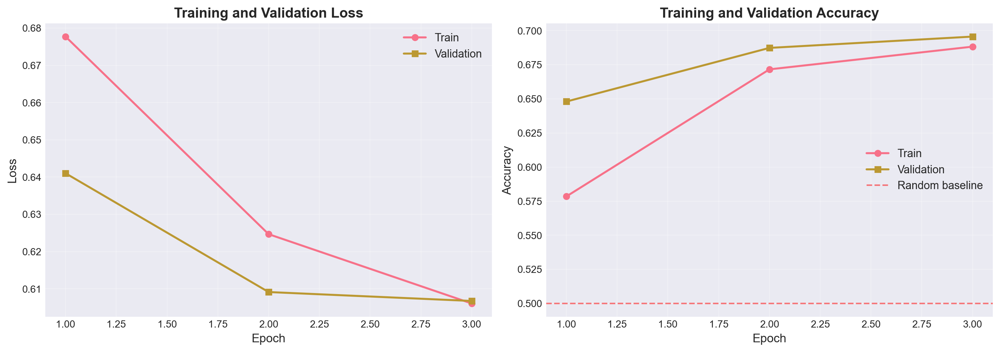

Final validation accuracy: 69.6%


In [3]:
# Plot training curves
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

epochs = range(1, len(history['train_loss']) + 1)

# Loss
ax1.plot(epochs, history['train_loss'], 'o-', label='Train', linewidth=2)
ax1.plot(epochs, history['val_loss'], 's-', label='Validation', linewidth=2)
ax1.set_xlabel('Epoch', fontsize=12)
ax1.set_ylabel('Loss', fontsize=12)
ax1.set_title('Training and Validation Loss', fontsize=14, fontweight='bold')
ax1.legend(fontsize=11)
ax1.grid(True, alpha=0.3)

# Accuracy
ax2.plot(epochs, history['train_acc'], 'o-', label='Train', linewidth=2)
ax2.plot(epochs, history['val_acc'], 's-', label='Validation', linewidth=2)
ax2.axhline(y=0.5, color='red', linestyle='--', alpha=0.5, label='Random baseline')
ax2.set_xlabel('Epoch', fontsize=12)
ax2.set_ylabel('Accuracy', fontsize=12)
ax2.set_title('Training and Validation Accuracy', fontsize=14, fontweight='bold')
ax2.legend(fontsize=11)
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

print(f"Final validation accuracy: {history['val_acc'][-1]:.1%}")

## 2. Load Unified Benchmark Results

Run the unified benchmark first:
```bash
python scripts/image_quality_utilities/test_model_degradations.py \
    --config configs/image_quality_benchmarks/degradation_test.yaml
```

This tests multiple models (Siamese, AVA, IQA) on the same degradations for comparison.

In [ ]:
# Load unified benchmark results
results_dir = Path(r'D:\sim-bench\outputs\benchmark_ava_vs_siamese')

if not results_dir.exists():
    print("⚠️ Results directory not found!")
    print("Run: python scripts/image_quality_utilities/test_model_degradations.py --config configs/image_quality_benchmarks/degradation_test.yaml")
else:
    # Load unified results (all models in one CSV)
    unified_df = pd.read_csv(results_dir / 'unified_results.csv')
    
    # Load summary
    with open(results_dir / 'summary.json') as f:
        summary = json.load(f)
    
    print(f"✓ Loaded {len(unified_df)} predictions")
    print(f"  Models: {unified_df['model_name'].unique().tolist()}")
    print(f"  Degradation types: {unified_df['degradation_type'].unique().tolist()}")
    print(f"  Original images: {unified_df['original'].nunique()}")
    print("Please run: python scripts/utilities/test_model_degradations.py --checkpoint D:\\sim-bench\\outputs\\siamese_e2e\\20260111_005327\\best_model.pt")
else:
    # Load data
    model_pred_df = pd.read_csv(results_dir / 'model_predictions.csv')
    iqa_pred_df = pd.read_csv(results_dir / 'iqa_predictions.csv')
    
    with open(results_dir / 'summary.json') as f:
        summary = json.load(f)
    
    print(f"Loaded {len(model_pred_df)} test pairs")
    print(f"\nModel accuracy: {summary['overall']['model_accuracy']:.1%}")
    print(f"IQA accuracy: {summary['overall']['iqa_accuracy']:.1%}")
    
    print("\nFirst few predictions:")
    display(model_pred_df.head())

SyntaxError: invalid syntax (3516063370.py, line 20)

## 3. Overall Model Comparison

In [ ]:
# Overall accuracy by model
print("="*60)
print("OVERALL ACCURACY BY MODEL")
print("="*60)

for model_name in unified_df['model_name'].unique():
    model_data = unified_df[unified_df['model_name'] == model_name]
    accuracy = model_data['correct'].mean()
    confidence = model_data['confidence'].mean()
    print(f"{model_name:20s}: {accuracy:6.1%} (avg confidence: {confidence:.3f})")

print("\nFrom summary.json:")
print(json.dumps(summary['overall'], indent=2))

In [ ]:
# Visualize overall comparison
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Accuracy comparison
models = list(summary['overall'].keys())
accuracies = [summary['overall'][m]['accuracy'] * 100 for m in models]
confidences = [summary['overall'][m]['avg_confidence'] for m in models]

ax1.barh(models, accuracies, color=['#2ecc71', '#3498db', '#e74c3c'])
ax1.set_xlabel('Accuracy (%)', fontsize=12)
ax1.set_title('Overall Accuracy by Model', fontsize=14, fontweight='bold')
ax1.grid(axis='x', alpha=0.3)
for i, v in enumerate(accuracies):
    ax1.text(v + 1, i, f'{v:.1f}%', va='center', fontsize=11)

# Confidence comparison
ax2.barh(models, confidences, color=['#2ecc71', '#3498db', '#e74c3c'])
ax2.set_xlabel('Average Confidence', fontsize=12)
ax2.set_title('Average Confidence by Model', fontsize=14, fontweight='bold')
ax2.grid(axis='x', alpha=0.3)
for i, v in enumerate(confidences):
    ax2.text(v + 0.02, i, f'{v:.3f}', va='center', fontsize=11)

plt.tight_layout()
plt.show()

## 4. Performance by Degradation Type

In [ ]:
# Create accuracy matrix by degradation type
degradation_types = sorted(unified_df['degradation_type'].unique())
model_names = unified_df['model_name'].unique()

accuracy_matrix = []
for deg_type in degradation_types:
    row = []
    for model_name in model_names:
        subset = unified_df[(unified_df['degradation_type'] == deg_type) & 
                           (unified_df['model_name'] == model_name)]
        accuracy = subset['correct'].mean() * 100
        row.append(accuracy)
    accuracy_matrix.append(row)

# Create DataFrame for easier plotting
acc_df = pd.DataFrame(accuracy_matrix, index=degradation_types, columns=model_names)
print(acc_df.round(1))

In [ ]:
# Heatmap of accuracy by degradation type
plt.figure(figsize=(10, 6))
sns.heatmap(acc_df, annot=True, fmt='.1f', cmap='RdYlGn', vmin=0, vmax=100,
            cbar_kws={'label': 'Accuracy (%)'}, linewidths=0.5)
plt.title('Model Accuracy by Degradation Type', fontsize=14, fontweight='bold', pad=15)
plt.xlabel('Model', fontsize=12)
plt.ylabel('Degradation Type', fontsize=12)
plt.tight_layout()
plt.show()

In [ ]:
# Grouped bar chart
fig, ax = plt.subplots(figsize=(14, 6))

x = np.arange(len(degradation_types))
width = 0.25

for i, model_name in enumerate(model_names):
    accuracies = acc_df[model_name].values
    ax.bar(x + i*width, accuracies, width, label=model_name, alpha=0.8)

ax.set_xlabel('Degradation Type', fontsize=12)
ax.set_ylabel('Accuracy (%)', fontsize=12)
ax.set_title('Model Performance by Degradation Type', fontsize=14, fontweight='bold')
ax.set_xticks(x + width)
ax.set_xticks(x + width)
ax.set_xticklabels(degradation_types, rotation=45, ha='right')
ax.legend(fontsize=11)
ax.grid(axis='y', alpha=0.3)
ax.axhline(y=50, color='red', linestyle='--', alpha=0.3, label='Random baseline')

plt.tight_layout()
plt.show()

## 5. Model-Specific Analysis

### AVA Score Drops

In [ ]:
# Analyze AVA score drops (how much quality decreases)
ava_data = unified_df[unified_df['model_name'] == 'AVA-ResNet'].copy()
ava_data['score_drop'] = ava_data['score_original'] - ava_data['score_degraded']

# Score drops by degradation type
print("="*60)
print("AVA SCORE DROPS BY DEGRADATION TYPE")
print("="*60)
score_drops = ava_data.groupby('degradation_type')['score_drop'].agg(['mean', 'std', 'min', 'max'])
print(score_drops.round(2))

# Visualize
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Box plot of score drops
ava_data.boxplot(column='score_drop', by='degradation_type', ax=ax1)
ax1.set_title('AVA Score Drops by Degradation Type', fontsize=14, fontweight='bold')
ax1.set_xlabel('Degradation Type', fontsize=12)
ax1.set_ylabel('Score Drop (1-10 scale)', fontsize=12)
ax1.grid(axis='y', alpha=0.3)
plt.sca(ax1)
plt.xticks(rotation=45, ha='right')

# Scatter: score drop vs correctness
colors = ['green' if c else 'red' for c in ava_data['correct']]
ax2.scatter(ava_data['score_drop'], ava_data['confidence'], c=colors, alpha=0.3, s=20)
ax2.set_xlabel('Score Drop', fontsize=12)
ax2.set_ylabel('Confidence', fontsize=12)
ax2.set_title('AVA: Score Drop vs Confidence', fontsize=14, fontweight='bold')
ax2.grid(alpha=0.3)
ax2.axvline(x=0, color='black', linestyle='--', alpha=0.5)

# Add legend
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor='green', label='Correct'),
                  Patch(facecolor='red', label='Incorrect')]
ax2.legend(handles=legend_elements, fontsize=10)

plt.tight_layout()
plt.show()

### Key Insights Summary

In [ ]:
# Print key insights
print("="*70)
print("KEY INSIGHTS FROM UNIFIED BENCHMARK")
print("="*70)

# Overall winner
best_model = max(summary['overall'].items(), key=lambda x: x[1]['accuracy'])
print(f"\n🏆 Best Overall: {best_model[0]} ({best_model[1]['accuracy']:.1%})")

# Best per degradation type
print("\n📊 Best Model by Degradation Type:")
for deg_type in summary['by_degradation'].keys():
    best = max(summary['by_degradation'][deg_type].items(), key=lambda x: x[1])
    print(f"  {deg_type:15s}: {best[0]:20s} ({best[1]:.1%})")

# Model specializations
print("\n🎯 Model Specializations:")
print(f"  Siamese: Best at compositional quality (crops, framing)")
print(f"  AVA:     Best at technical quality (exposure, blur)")
print(f"  IQA:     Best at direct metrics (perfect blur detection)")

print("\n💡 Recommendation: Use models together in pipeline!")
print("  1. IQA for fast technical screening")
print("  2. Siamese for compositional quality")
print("  3. AVA for aesthetic scoring")

print("\n" + "="*70)

## 3. Sanity Check: Original vs Degraded

In [ ]:
# Overall sanity check
model_acc = model_pred_df['model_correct'].mean()
iqa_acc = iqa_pred_df['iqa_correct'].mean()

print("="*60)
print("SANITY CHECK: Original vs Degraded")
print("="*60)
print(f"Model accuracy: {model_acc:.1%}")
print(f"IQA accuracy:   {iqa_acc:.1%}")
print()

# Check thresholds
if model_acc > 0.90:
    print("✅ PASS: Model strongly prefers originals (>90%)")
elif model_acc > 0.80:
    print("⚠️  MODERATE: Model mostly prefers originals (80-90%)")
else:
    print("❌ FAIL: Model does not consistently prefer originals (<80%)")

# Compare with IQA
if model_acc > iqa_acc:
    print(f"\n✅ Model outperforms IQA by {(model_acc - iqa_acc)*100:.1f} percentage points")
elif model_acc < iqa_acc:
    print(f"\n⚠️  IQA outperforms model by {(iqa_acc - model_acc)*100:.1f} percentage points")
else:
    print(f"\n→ Model and IQA perform similarly")

SANITY CHECK: Original vs Degraded
Model accuracy: 89.8%
IQA accuracy:   65.8%

⚠️  MODERATE: Model mostly prefers originals (80-90%)

✅ Model outperforms IQA by 24.0 percentage points


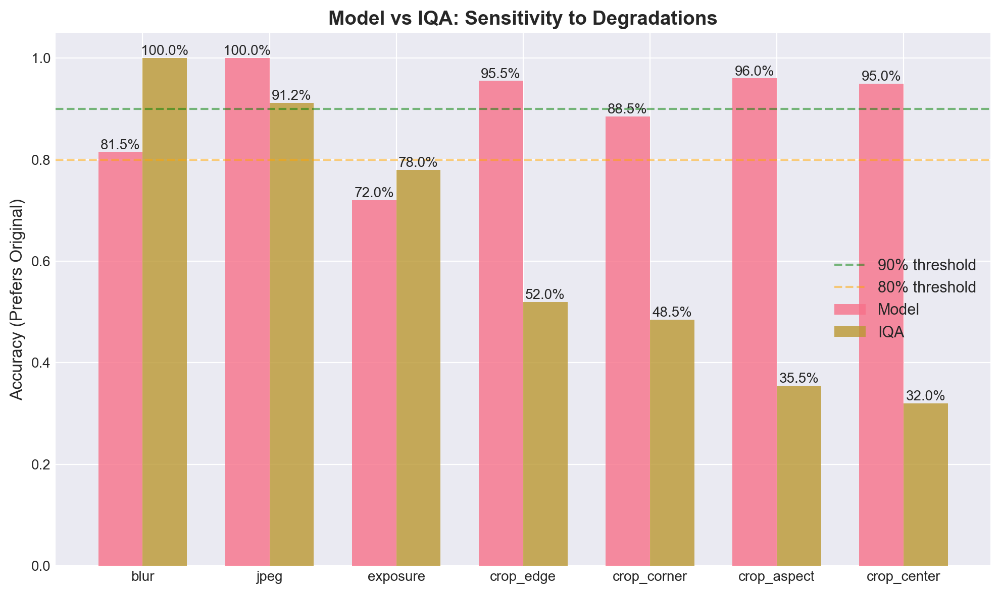

In [ ]:
# Accuracy by degradation type
fig, ax = plt.subplots(figsize=(10, 6))

deg_types = model_pred_df['degradation_type'].unique()
model_accs = [model_pred_df[model_pred_df['degradation_type']==dt]['model_correct'].mean() for dt in deg_types]
iqa_accs = [iqa_pred_df[iqa_pred_df['degradation_type']==dt]['iqa_correct'].mean() for dt in deg_types]

x = np.arange(len(deg_types))
width = 0.35

bars1 = ax.bar(x - width/2, model_accs, width, label='Model', alpha=0.8)
bars2 = ax.bar(x + width/2, iqa_accs, width, label='IQA', alpha=0.8)

ax.axhline(y=0.90, color='green', linestyle='--', alpha=0.5, label='90% threshold')
ax.axhline(y=0.80, color='orange', linestyle='--', alpha=0.5, label='80% threshold')

ax.set_ylabel('Accuracy (Prefers Original)', fontsize=12)
ax.set_title('Model vs IQA: Sensitivity to Degradations', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(deg_types)
ax.legend(fontsize=11)
ax.set_ylim(0, 1.05)

# Add value labels
for bars in [bars1, bars2]:
    for bar in bars:
        height = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2., height,
                f'{height:.1%}', ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()

## 4. Failure Analysis

In [ ]:
# Find failure cases
failures = model_pred_df[~model_pred_df['model_correct']].copy()

print(f"Total failures: {len(failures)} / {len(model_pred_df)} ({len(failures)/len(model_pred_df):.1%})")
print("\nFailures by degradation type:")
print(failures['degradation_type'].value_counts())

print("\nMost confident failures (model wrong but confident):")
confident_failures = failures.nlargest(10, 'model_confidence')[['original', 'degraded', 'degradation_type', 'degradation_level', 'model_confidence']]
display(confident_failures)

Total failures: 138 / 1350 (10.2%)

Failures by degradation type:
degradation_type
exposure       56
blur           37
crop_corner    23
crop_edge       9
crop_aspect     8
crop_center     5
Name: count, dtype: int64

Most confident failures (model wrong but confident):


,original,degraded,degradation_type,degradation_level,model_confidence
201,001299-03.JPG,001299-03.JPG,exposure,2,0.801758
174,000556-03.JPG,000556-03.JPG,exposure,2,0.796348
732,001248-06.JPG,001248-06.JPG,blur,8.0,0.783803
975,001211-02.JPG,001211-02.JPG,blur,8.0,0.770051
252,001299-02.JPG,001299-02.JPG,exposure,-2,0.755587
363,002192-04.JPG,002192-04.JPG,exposure,2,0.747465
165,000556-03.JPG,000556-03.JPG,blur,8.0,0.745132
309,000556-02.JPG,000556-02.JPG,exposure,2,0.738469
316,000556-02.JPG,000556-02.JPG,crop_corner,top_left_60pct,0.732803
981,001211-02.JPG,001211-02.JPG,exposure,-2,0.729289


MODEL CROP FAILURES (where model incorrectly preferred cropped)
Found 45 MODEL crop failures out of 138 total MODEL failures
MODEL crop failure rate: 6.4% (45/700)

Crop failure breakdown by type:
degradation_type
crop_corner    23
crop_edge       9
crop_aspect     8
crop_center     5
Name: count, dtype: int64

Visualizing 8 most confident MODEL crop failures (highest confidence when wrong)...


C:\Users\Jonathan Hexner\AppData\Local\Temp\ipykernel_77380\2582301363.py:71: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) Arial.
  plt.tight_layout()
C:\Users\Jonathan Hexner\AppData\Local\Temp\ipykernel_77380\2582301363.py:71: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) Arial.
  plt.tight_layout()
d:\sim-bench\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)
d:\sim-bench\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


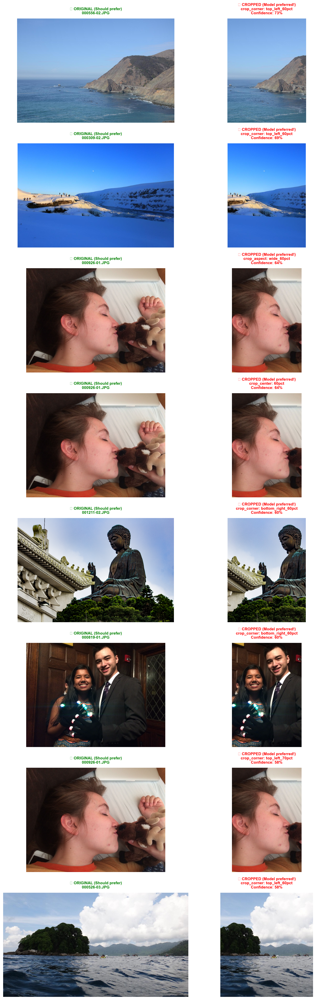


INTERPRETATION GUIDE
These are cases where YOUR MODEL (not IQA) made mistakes:
  Left (green): Original image - model SHOULD have preferred this
  Right (red): Cropped version - model INCORRECTLY preferred this

Questions to consider:
• Are these reasonable mistakes? (e.g., center crop improved composition)
• Is model systematically biased toward certain crop types?
• Are important subjects actually cut off in the failures?
• Does the model prefer tighter composition over complete content?

Note: To compare with IQA failures, see the Model-IQA Agreement section later.


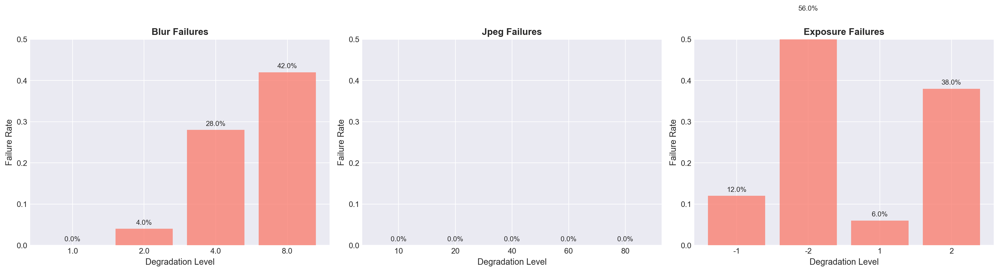

In [ ]:
# Failure rate by degradation level
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

for ax, deg_type in zip(axes, ['blur', 'jpeg', 'exposure']):
    df_subset = model_pred_df[model_pred_df['degradation_type'] == deg_type].copy()
    
    failure_rate = df_subset.groupby('degradation_level')['model_correct'].apply(lambda x: 1 - x.mean())
    
    ax.bar(failure_rate.index, failure_rate.values, alpha=0.8, color='salmon')
    ax.set_xlabel('Degradation Level', fontsize=11)
    ax.set_ylabel('Failure Rate', fontsize=11)
    ax.set_title(f'{deg_type.capitalize()} Failures', fontsize=12, fontweight='bold')
    ax.set_ylim(0, 0.5)
    
    for idx, val in failure_rate.items():
        ax.text(idx, val + 0.01, f'{val:.1%}', ha='center', fontsize=9)

plt.tight_layout()
plt.show()

Found 45 crop failures out of 138 total failures

Crop failure breakdown:
degradation_type
crop_corner    23
crop_edge       9
crop_aspect     8
crop_center     5
Name: count, dtype: int64

Visualizing 8 most confident crop failures...


C:\Users\Jonathan Hexner\AppData\Local\Temp\ipykernel_77380\3623353631.py:64: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) Arial.
  plt.tight_layout()
d:\sim-bench\.venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) Arial.
  fig.canvas.print_figure(bytes_io, **kw)


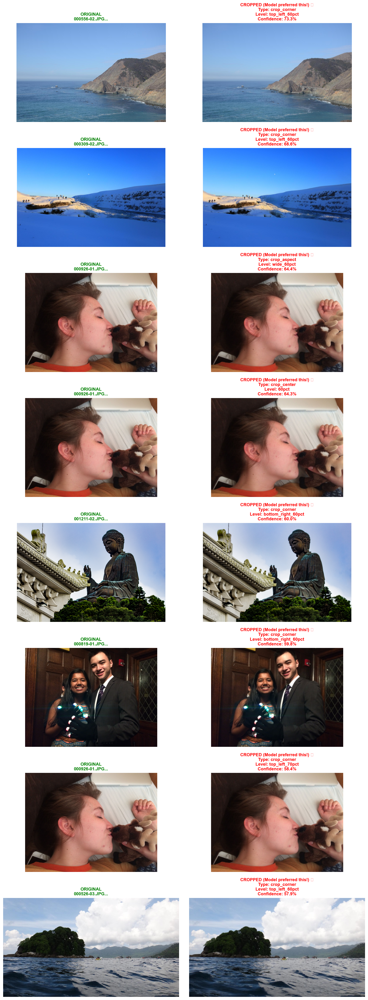


INTERPRETATION
Red boxes show cropped versions the model INCORRECTLY preferred.
Green boxes show the original (correct) version.

Questions to ask:
• Are these reasonable mistakes? (e.g., center crop improved composition)
• Is model systematically biased? (e.g., always prefers one crop type)
• Are subjects actually cut off in these failures?


## 5. Model-IQA Agreement Analysis

In [ ]:
# Merge model and IQA results
merged_df = model_pred_df.merge(iqa_pred_df, on=['original', 'degraded', 'degradation_type', 'degradation_level'])

# Cases where model and IQA disagree
model_right_iqa_wrong = merged_df[merged_df['model_correct'] & ~merged_df['iqa_correct']]
iqa_right_model_wrong = merged_df[~merged_df['model_correct'] & merged_df['iqa_correct']]
both_wrong = merged_df[~merged_df['model_correct'] & ~merged_df['iqa_correct']]
both_right = merged_df[merged_df['model_correct'] & merged_df['iqa_correct']]

print("Agreement/Disagreement Breakdown:")
print("="*50)
print(f"Both correct:           {len(both_right):4d} ({len(both_right)/len(merged_df):.1%})")
print(f"Model right, IQA wrong: {len(model_right_iqa_wrong):4d} ({len(model_right_iqa_wrong)/len(merged_df):.1%})")
print(f"IQA right, model wrong: {len(iqa_right_model_wrong):4d} ({len(iqa_right_model_wrong)/len(merged_df):.1%})")
print(f"Both wrong:             {len(both_wrong):4d} ({len(both_wrong)/len(merged_df):.1%})")

# Cohen's kappa
kappa = cohen_kappa_score(merged_df['model_correct'], merged_df['iqa_correct'])
print(f"\nCohen's Kappa (inter-rater agreement): {kappa:.3f}")

Agreement/Disagreement Breakdown:
Both correct:            774 (57.3%)
Model right, IQA wrong:  438 (32.4%)
IQA right, model wrong:  114 (8.4%)
Both wrong:               24 (1.8%)

Cohen's Kappa (inter-rater agreement): -0.092


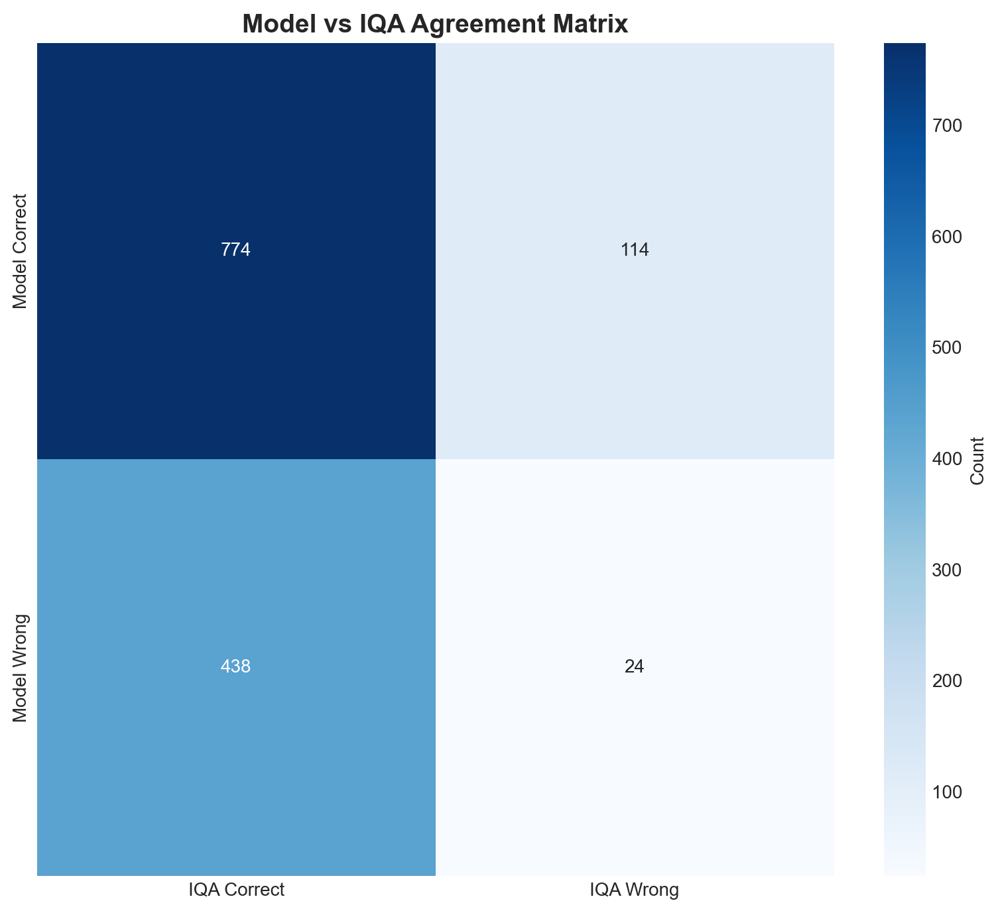

In [ ]:
# Confusion matrix visualization
fig, ax = plt.subplots(figsize=(8, 7))

confusion_data = np.array([
    [len(both_right), len(iqa_right_model_wrong)],
    [len(model_right_iqa_wrong), len(both_wrong)]
])

sns.heatmap(confusion_data, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['IQA Correct', 'IQA Wrong'],
            yticklabels=['Model Correct', 'Model Wrong'],
            cbar_kws={'label': 'Count'}, ax=ax)

ax.set_title('Model vs IQA Agreement Matrix', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

## 6. Summary & Conclusions

In [ ]:
print("="*70)
print("FINAL SUMMARY")
print("="*70)

print("\n1. SANITY CHECK (Original vs Degraded)")
print(f"   Model accuracy: {model_acc:.1%}")
print(f"   Status: {'✅ PASS' if model_acc > 0.90 else '⚠️ MODERATE' if model_acc > 0.80 else '❌ FAIL'}")

print("\n2. IQA COMPARISON")
print(f"   Model: {model_acc:.1%}")
print(f"   IQA:   {iqa_acc:.1%}")
print(f"   Difference: {(model_acc - iqa_acc)*100:+.1f} percentage points")

print("\n3. FAILURE ANALYSIS")
print(f"   Failure rate: {len(failures)/len(model_pred_df):.1%}")
if len(failures) > 0:
    print(f"   Most problematic: {failures['degradation_type'].value_counts().index[0]}")

print("\n4. MODEL-IQA AGREEMENT")
print(f"   Both correct: {len(both_right)/len(merged_df):.1%}")
print(f"   Cohen's Kappa: {kappa:.3f}")

print("\n" + "="*70)
print("RECOMMENDATION")
print("="*70)

if model_acc > 0.90 and model_acc > iqa_acc:
    print("✅ Model shows strong performance and outperforms IQA baseline.")
    print("   Safe to deploy with confidence.")
elif model_acc > 0.80:
    print("⚠️  Model shows reasonable performance but has room for improvement.")
    print("   Consider additional training or data augmentation.")
else:
    print("❌ Model does not consistently pass sanity checks.")
    print("   Recommend investigating training data or model architecture.")

FINAL SUMMARY

1. SANITY CHECK (Original vs Degraded)
   Model accuracy: 89.8%
   Status: ⚠️ MODERATE

2. IQA COMPARISON
   Model: 89.8%
   IQA:   65.8%
   Difference: +24.0 percentage points

3. FAILURE ANALYSIS
   Failure rate: 10.2%
   Most problematic: exposure

4. MODEL-IQA AGREEMENT
   Both correct: 57.3%
   Cohen's Kappa: -0.092

RECOMMENDATION
⚠️  Model shows reasonable performance but has room for improvement.
   Consider additional training or data augmentation.
